# Caso 3: Aseguradora

## 1. Entendimiento del Problema

El equipo de tarifación de la aseguradora requiere pronósticar el valor de la prima de los aseguradores dentro de la compañía

## 2. Enfoque Analítico

Se debe construir un modelo de regresión que permita predecir la prima con un MAPE menor o igual al 15%

## 3. Requerimiento de Datos

- Se requieren los datos de los aseguradores dentro de la compañía

## 4. Recolección de Datos

- age: edad del asegurado
- sex: género del asegurado
- bmi: índice de masa corporal del asegurado
- children: número de hijos del asegurado
- smoker: el asegurado es o no es fumador
- region: región comercial a la que pertenece el asegurado
- charges: valor de la prima del asegurado

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
import numpy as np

import warnings
warnings.filterwarnings('ignore')

In [2]:
data = pd.read_csv('../Datasets/datos_caso_3.csv')
data

,age,sex,bmi,children,smoker,region,charges
0,19,female,27.900,0,yes,southwest,16884.92400
1,18,male,33.770,1,no,southeast,1725.55230
2,28,male,33.000,3,no,southeast,4449.46200
3,33,male,22.705,0,no,northwest,21984.47061
4,32,male,28.880,0,no,northwest,3866.85520
...,...,...,...,...,...,...,...
1333,50,male,30.970,3,no,northwest,10600.54830
1334,18,female,31.920,0,no,northeast,2205.98080
1335,18,female,36.850,0,no,southeast,1629.83350
1336,21,female,25.800,0,no,southwest,2007.94500


## 5. Entendimiento de los Datos

### Valores Nulos

<Axes: >

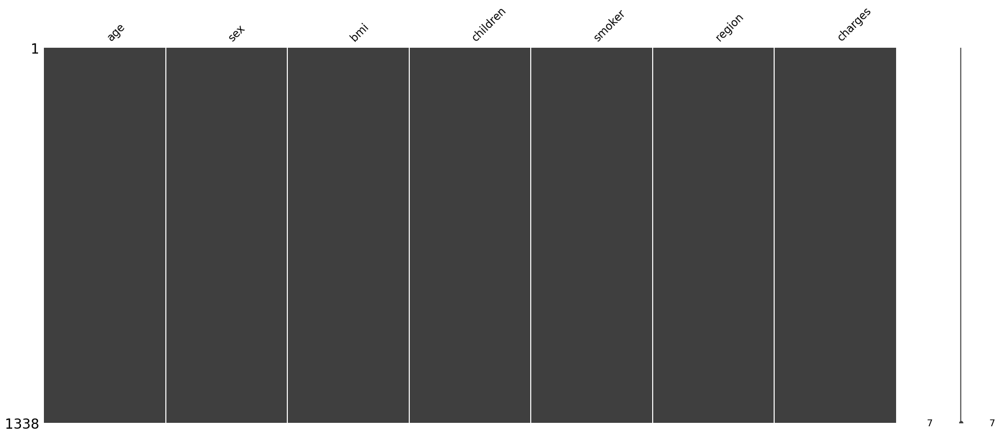

In [3]:
msno.matrix(data)

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1338 entries, 0 to 1337
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   age       1338 non-null   int64  
 1   sex       1338 non-null   object 
 2   bmi       1338 non-null   float64
 3   children  1338 non-null   int64  
 4   smoker    1338 non-null   object 
 5   region    1338 non-null   object 
 6   charges   1338 non-null   float64
dtypes: float64(2), int64(2), object(3)
memory usage: 73.3+ KB


### Análisis Variable Y

- Posee un comportamiento normal al tratarse de temas financieros con una curva exponencial

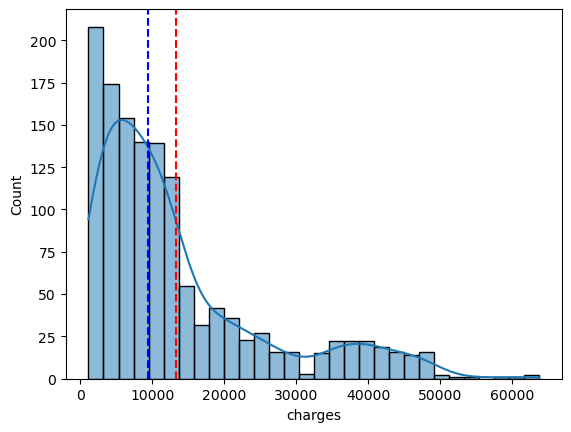

In [5]:
sns.histplot(data, x = "charges", kde=True)
plt.axvline(data["charges"].mean(), color='red', linestyle='--')
plt.axvline(data["charges"].median(), color='blue', linestyle='--')
plt.show()

### Histogramas de Frecuencia

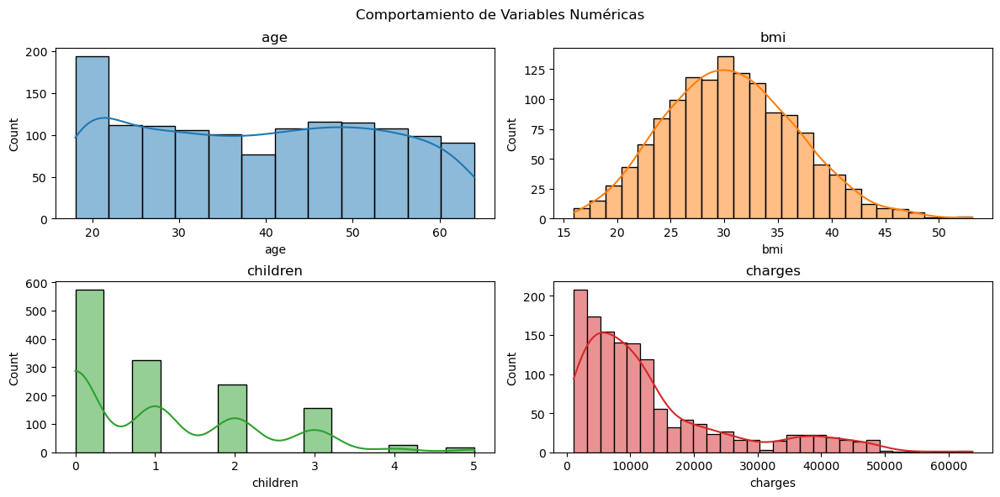

In [6]:
fig, ax = plt.subplots(2, 2, figsize = (12, 6))
ax = ax.flat
num_col = data.select_dtypes(include = ['int64', 'float64']).columns
for i, col in enumerate(num_col):
    sns.histplot(data = data, x = col, 
                kde = True, color = (list(plt.rcParams['axes.prop_cycle']) * 7)[i]['color'], ax = ax[i])
    ax[i].set_title(col)
fig.tight_layout()
fig.subplots_adjust(top = 0.9)
fig.suptitle('Comportamiento de Variables Numéricas')
plt.show()

### Gráficos de Torta

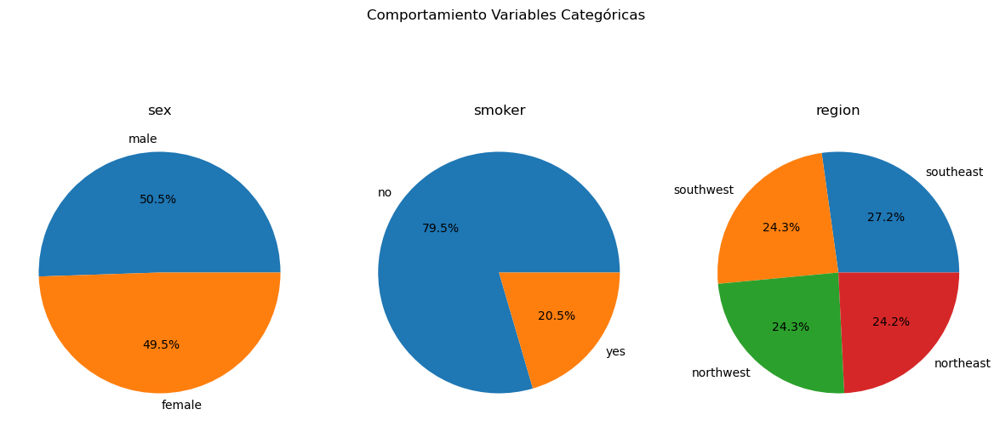

In [7]:
fig, ax = plt.subplots(1, 3, figsize = (12, 6))
ax = ax.flat
cat_col = data.select_dtypes(include = ['object']).columns
for i, col in enumerate(cat_col):
    ax[i].pie(x = data[col].value_counts(), labels = data[col].value_counts().index, autopct = '%0.1f%%')
    ax[i].set_title(col)
fig.tight_layout()
fig.subplots_adjust(top = 0.9)
fig.suptitle("Comportamiento Variables Categóricas")
plt.show()

### Factor de Correlación

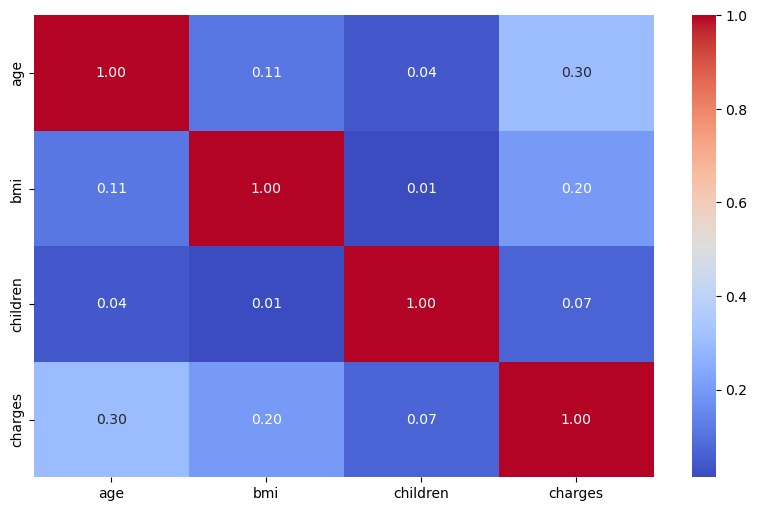

In [8]:
plt.figure(figsize = (10, 6))
sns.heatmap(data.corr(numeric_only=True), annot=True, fmt=".2f", cmap="coolwarm")
plt.show()

## 6. Preparación de los datos

In [9]:
data_clean = data.drop(columns = ['smoker'])
data_clean

,age,sex,bmi,children,region,charges
0,19,female,27.900,0,southwest,16884.92400
1,18,male,33.770,1,southeast,1725.55230
2,28,male,33.000,3,southeast,4449.46200
3,33,male,22.705,0,northwest,21984.47061
4,32,male,28.880,0,northwest,3866.85520
...,...,...,...,...,...,...
1333,50,male,30.970,3,northwest,10600.54830
1334,18,female,31.920,0,northeast,2205.98080
1335,18,female,36.850,0,southeast,1629.83350
1336,21,female,25.800,0,southwest,2007.94500


In [10]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler
from sklearn.pipeline import Pipeline

### Transformación de los Datos

In [11]:
num_col = data_clean.select_dtypes(include = ['int64', 'float64']).columns
cat_col = data_clean.select_dtypes(include = ['object']).columns

num_trans = Pipeline(steps = [('scaler', MinMaxScaler())])
cat_trans = Pipeline(steps = [('onehot', OneHotEncoder())])

preprocessor = ColumnTransformer(transformers = [
    ('num', num_trans, num_col),
    ('cat', cat_trans, cat_col)
])

preprocessor

ColumnTransformer(transformers=[('num',
                                 Pipeline(steps=[('scaler', MinMaxScaler())]),
                                 Index(['age', 'bmi', 'children', 'charges'], dtype='object')),
                                ('cat',
                                 Pipeline(steps=[('onehot', OneHotEncoder())]),
                                 Index(['sex', 'region'], dtype='object'))])

In [12]:
data_pre = preprocessor.fit_transform(data_clean)
cod_cat = preprocessor.named_transformers_['cat']['onehot'].get_feature_names_out(cat_col)
labels = np.concatenate([num_col, cod_cat])
data_pro = pd.DataFrame(data_pre, columns = labels)
data_pro = data_pro[(data_pro['charges'] != 0)]
data_pro

,age,bmi,children,charges,sex_female,sex_male,region_northeast,region_northwest,region_southeast,region_southwest
0,0.021739,0.321227,0.0,0.251611,1.0,0.0,0.0,0.0,0.0,1.0
1,0.000000,0.479150,0.2,0.009636,0.0,1.0,0.0,0.0,1.0,0.0
2,0.217391,0.458434,0.6,0.053115,0.0,1.0,0.0,0.0,1.0,0.0
3,0.326087,0.181464,0.0,0.333010,0.0,1.0,0.0,1.0,0.0,0.0
4,0.304348,0.347592,0.0,0.043816,0.0,1.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...
1333,0.695652,0.403820,0.6,0.151299,0.0,1.0,0.0,1.0,0.0,0.0
1334,0.000000,0.429379,0.0,0.017305,1.0,0.0,1.0,0.0,0.0,0.0
1335,0.000000,0.562012,0.0,0.008108,1.0,0.0,0.0,0.0,1.0,0.0
1336,0.065217,0.264730,0.0,0.014144,1.0,0.0,0.0,0.0,0.0,1.0


### Conjunto de Entrenamiento

- Debido a que la evaluación se va a realizar mediante MAPE se eliminó el único registro que tenía un 0 dentro de la variable Y (Charges) para poder medirlo bien y que no tienda a infinito

In [13]:
from sklearn.model_selection import train_test_split

El tamaño del conjunto de entrenamiento es: 935 935
El tamaño del conjunto de prueba es: 402 402


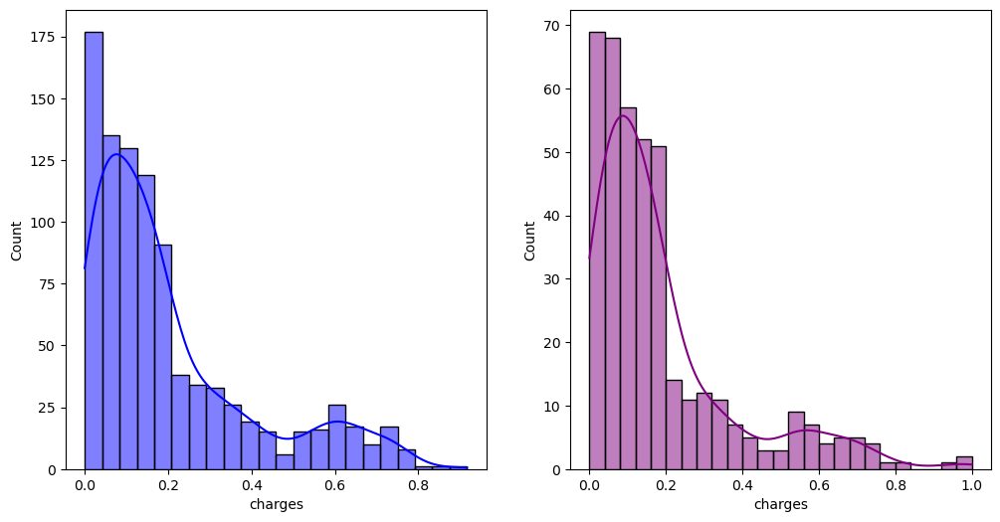

In [14]:
X = data_pro.drop(columns = ['charges'])
y = data_pro['charges']

X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.7, random_state = 123)
print(f'El tamaño del conjunto de entrenamiento es: {X_train.shape[0]} {y_train.shape[0]}')
print(f'El tamaño del conjunto de prueba es: {X_test.shape[0]} {y_test.shape[0]}')
fig, ax = plt.subplots(1, 2, figsize = (12, 6))
sns.histplot(y_train, kde = True, color = 'blue', ax = ax[0])
sns.histplot(y_test, kde = True, color = 'purple', ax = ax[1])
plt.show()

## 7. Modelos

In [15]:
from sklearn.metrics import r2_score, mean_absolute_error, root_mean_squared_error, mean_absolute_percentage_error
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

### Regresión Lineal

In [16]:
from sklearn.linear_model import LinearRegression

In [17]:
modelo_1 = LinearRegression()
modelo_1.fit(X_train, y_train)

LinearRegression()

In [18]:
modelo_1.intercept_

np.float64(0.02602025870850727)

In [19]:
modelo_1.coef_

array([ 0.17461564,  0.20330381,  0.04921954, -0.01074393,  0.01074393,
        0.0137659 , -0.00866701,  0.01638787, -0.02148676])

In [20]:
pred_train_1 = modelo_1.predict(X_train)
pred_test_1 = modelo_1.predict(X_test)
# Desecalamiento con fórmula matemática
pred_train_desc_1 = pred_train_1 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_1 = pred_test_1 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.13126812074290328
MAE entrenamiento: 0.14631432509422354
RMSE entrenamiento: 0.1816800902956023
MAPE entrenamiento: 4.4657962263124675


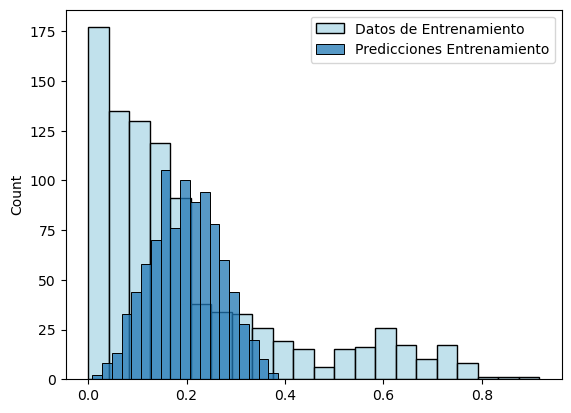

In [21]:
r2_train_1 = r2_score(y_train_desc, pred_train_desc_1)
mae_train_1 = mean_absolute_error(y_train_desc, pred_train_desc_1)
rmse_train_1 = root_mean_squared_error(y_train_desc, pred_train_desc_1)
mape_train_1 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_1)

print(f'R2 entrenamiento: {r2_train_1}')
print(f'MAE entrenamiento: {mae_train_1}')
print(f'RMSE entrenamiento: {rmse_train_1}')
print(f'MAPE entrenamiento: {mape_train_1}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_1.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: 0.10438080313566822
MAE prueba: 0.13932919385211773
RMSE prueba: 0.1786274408873479
MAPE prueba: 4.641546005490532


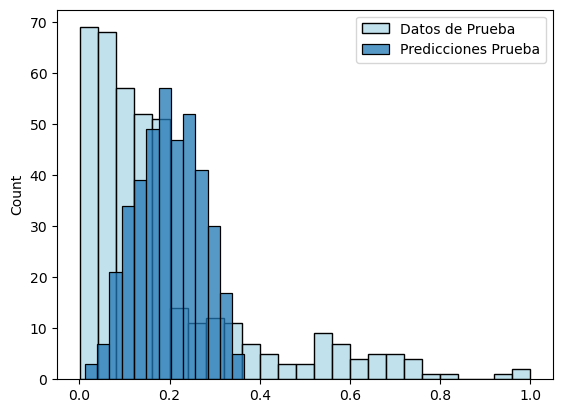

In [22]:
r2_test_1 = r2_score(y_test_desc, pred_test_desc_1)
mae_test_1 = mean_absolute_error(y_test_desc, pred_test_desc_1)
rmse_test_1 = root_mean_squared_error(y_test_desc, pred_test_desc_1)
mape_test_1 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_1)

print(f'R2 prueba: {r2_test_1}')
print(f'MAE prueba: {mae_test_1}')
print(f'RMSE prueba: {rmse_test_1}')
print(f'MAPE prueba: {mape_test_1}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_1.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### K Vecinos Mas Cercanos

In [23]:
from sklearn.neighbors import KNeighborsRegressor

In [24]:
modelo_2 = KNeighborsRegressor()
param_grid = {'n_neighbors': [2, 3, 5, 7, 11, 21, 35, 60, 100], 'p': [1, 2]}
reg_2 = GridSearchCV(modelo_2, param_grid, cv = 5, n_jobs = -1, scoring = 'neg_mean_absolute_percentage_error')
reg_2.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=KNeighborsRegressor(), n_jobs=-1,
             param_grid={'n_neighbors': [2, 3, 5, 7, 11, 21, 35, 60, 100],
                         'p': [1, 2]},
             scoring='neg_mean_absolute_percentage_error')

In [25]:
validation = pd.concat([pd.DataFrame(reg_2.cv_results_['params']), 
                        pd.DataFrame(reg_2.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

,n_neighbors,p,MAPE
8,11,1,-4.413604
9,11,2,-4.842732
3,3,2,-5.172608
4,5,1,-5.202535
6,7,1,-5.327003
5,5,2,-5.431541
7,7,2,-5.528092
11,21,2,-5.658705
2,3,1,-5.682455
10,21,1,-5.683462


In [26]:
modelo_2_final = reg_2.best_estimator_
modelo_2_final

KNeighborsRegressor(n_neighbors=11, p=1)

In [27]:
pred_train_2 = modelo_2_final.predict(X_train)
pred_test_2 = modelo_2_final.predict(X_test)
# Desecalamiento con fórmula matemática
pred_train_desc_2 = pred_train_2 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_2 = pred_test_2 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.2211434373965565
MAE entrenamiento: 0.13073473196794225
RMSE entrenamiento: 0.17202564680887053
MAPE entrenamiento: 3.422397883754656


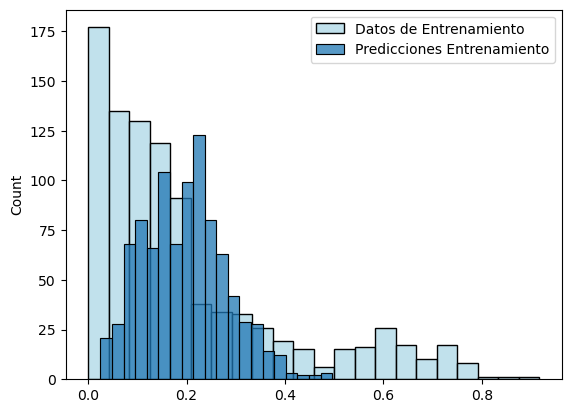

In [28]:
r2_train_2 = r2_score(y_train_desc, pred_train_desc_2)
mae_train_2 = mean_absolute_error(y_train_desc, pred_train_desc_2)
rmse_train_2 = root_mean_squared_error(y_train_desc, pred_train_desc_2)
mape_train_2 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_2)

print(f'R2 entrenamiento: {r2_train_2}')
print(f'MAE entrenamiento: {mae_train_2}')
print(f'RMSE entrenamiento: {rmse_train_2}')
print(f'MAPE entrenamiento: {mape_train_2}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_2.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: 0.07225993840750455
MAE prueba: 0.13677280624999635
RMSE prueba: 0.18180240949652615
MAPE prueba: 3.81201422682113


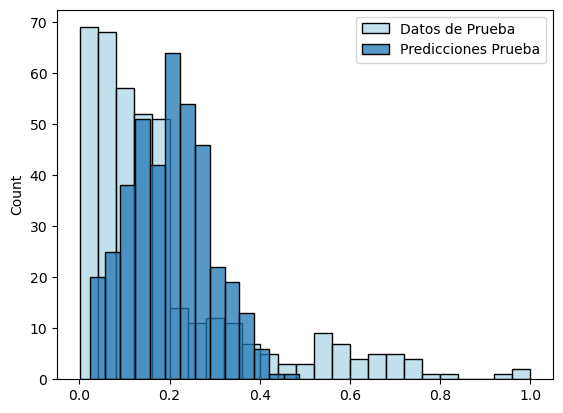

In [29]:
r2_test_2 = r2_score(y_test_desc, pred_test_desc_2)
mae_test_2 = mean_absolute_error(y_test_desc, pred_test_desc_2)
rmse_test_2 = root_mean_squared_error(y_test_desc, pred_test_desc_2)
mape_test_2 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_2)

print(f'R2 prueba: {r2_test_2}')
print(f'MAE prueba: {mae_test_2}')
print(f'RMSE prueba: {rmse_test_2}')
print(f'MAPE prueba: {mape_test_2}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_2.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### MSV

In [30]:
from sklearn.svm import SVR

In [31]:
modelo_3 = SVR()
param_grid = {'C': [0.01, 0.1, 1, 10, 100], 'kernel': ['linear', 'poly', 'rbf'], 'degree': [2, 3, 4]}
reg_3 = GridSearchCV(modelo_3, param_grid, cv = 5, n_jobs = -1, scoring = 'neg_mean_absolute_percentage_error')
reg_3.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_3.cv_results_['params']), 
                        pd.DataFrame(reg_3.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

,C,degree,kernel,MAPE
27,10.00,2,linear,-4.235235
30,10.00,3,linear,-4.235235
33,10.00,4,linear,-4.235235
36,100.00,2,linear,-4.237799
39,100.00,3,linear,-4.237799
42,100.00,4,linear,-4.237799
24,1.00,4,linear,-4.246595
18,1.00,2,linear,-4.246595
21,1.00,3,linear,-4.246595
9,0.10,2,linear,-4.270037


In [32]:
modelo_3_final = reg_3.best_estimator_
modelo_3_final

SVR(C=10, degree=2, kernel='linear')

In [33]:
pred_train_3 = modelo_3_final.predict(X_train)
pred_test_3 = modelo_3_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_3 = pred_train_3 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_3 = pred_test_3 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.08613316047446884
MAE entrenamiento: 0.14458748321138132
RMSE entrenamiento: 0.1863399253100847
MAPE entrenamiento: 3.3119869327149174


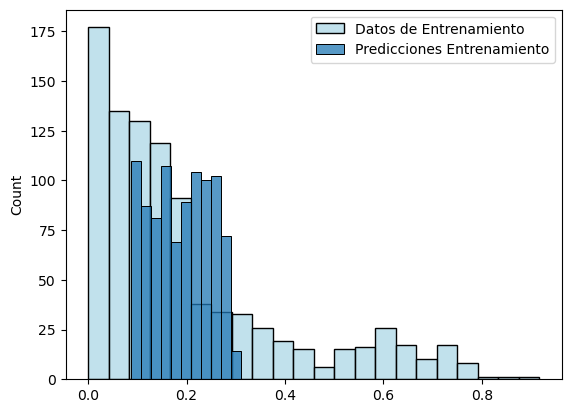

In [34]:
r2_train_3 = r2_score(y_train_desc, pred_train_desc_3)
mae_train_3 = mean_absolute_error(y_train_desc, pred_train_desc_3)
rmse_train_3 = root_mean_squared_error(y_train_desc, pred_train_desc_3)
mape_train_3 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_3)

print(f'R2 entrenamiento: {r2_train_3}')
print(f'MAE entrenamiento: {mae_train_3}')
print(f'RMSE entrenamiento: {rmse_train_3}')
print(f'MAPE entrenamiento: {mape_train_3}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_3.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: 0.07225993840750455
MAE prueba: 0.13652561004066582
RMSE prueba: 0.17903884830324876
MAPE prueba: 3.1582127164207723


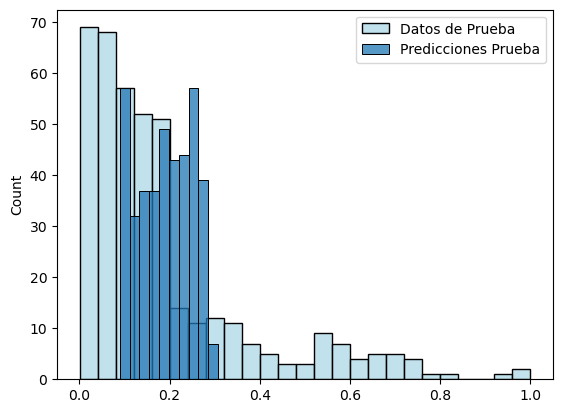

In [35]:
r2_test_3 = r2_score(y_test_desc, pred_test_desc_2)
mae_test_3 = mean_absolute_error(y_test_desc, pred_test_desc_3)
rmse_test_3 = root_mean_squared_error(y_test_desc, pred_test_desc_3)
mape_test_3 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_3)

print(f'R2 prueba: {r2_test_3}')
print(f'MAE prueba: {mae_test_3}')
print(f'RMSE prueba: {rmse_test_3}')
print(f'MAPE prueba: {mape_test_3}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_3.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### Árboles de Decisión

In [36]:
from sklearn.tree import DecisionTreeRegressor

In [37]:
modelo_4 = DecisionTreeRegressor(random_state=123)
param_grid = {'criterion': ['friedman_mse', 'poisson', 'squared_error', 'absolute_error'], 'max_depth': [None, 5, 10, 20], 'min_samples_split': [2, 3], 'max_leaf_nodes': [None, 2, 3, 4]}
reg_4 = GridSearchCV(modelo_4, param_grid, cv=3, scoring='neg_mean_absolute_percentage_error')
reg_4.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_4.cv_results_['params']), 
                        pd.DataFrame(reg_4.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

,criterion,max_depth,max_leaf_nodes,min_samples_split,MAPE
105,absolute_error,5.0,NaN,3,-0.907173
104,absolute_error,5.0,NaN,2,-0.907173
127,absolute_error,20.0,4.0,3,-1.109877
102,absolute_error,NaN,4.0,2,-1.109877
118,absolute_error,10.0,4.0,2,-1.109877
...,...,...,...,...,...
85,squared_error,10.0,3.0,3,-7.661650
69,squared_error,NaN,3.0,3,-7.661650
93,squared_error,20.0,3.0,3,-7.661650
32,poisson,NaN,NaN,2,-8.947827


In [38]:
modelo_4_final = reg_4.best_estimator_
modelo_4_final

DecisionTreeRegressor(criterion='absolute_error', max_depth=5, random_state=123)

In [39]:
pred_train_4 = modelo_4_final.predict(X_train)
pred_test_4 = modelo_4_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_4 = pred_train_4 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_4 = pred_test_4 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: -0.06861578369081278
MAE entrenamiento: 0.10322463623366712
RMSE entrenamiento: 0.20150009253173246
MAPE entrenamiento: 0.6357827867859932


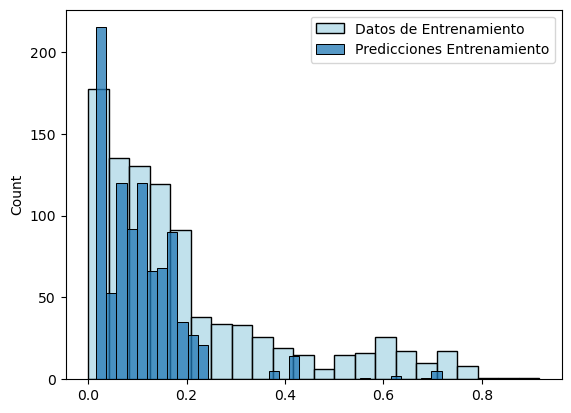

In [40]:
r2_train_4 = r2_score(y_train_desc, pred_train_desc_4)
mae_train_4 = mean_absolute_error(y_train_desc, pred_train_desc_4)
rmse_train_4 = root_mean_squared_error(y_train_desc, pred_train_desc_4)
mape_train_4 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_4)

print(f'R2 entrenamiento: {r2_train_4}')
print(f'MAE entrenamiento: {mae_train_4}')
print(f'RMSE entrenamiento: {rmse_train_4}')
print(f'MAPE entrenamiento: {mape_train_4}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_4.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: -0.1382301623076856
MAE prueba: 0.10009461108491377
RMSE prueba: 0.20137313182735442
MAPE prueba: 2.6882878556021543


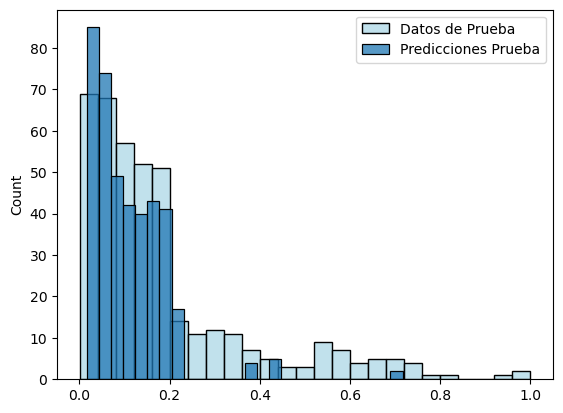

In [41]:
r2_test_4 = r2_score(y_test_desc, pred_test_desc_4)
mae_test_4 = mean_absolute_error(y_test_desc, pred_test_desc_4)
rmse_test_4 = root_mean_squared_error(y_test_desc, pred_test_desc_4)
mape_test_4 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_4)

print(f'R2 prueba: {r2_test_4}')
print(f'MAE prueba: {mae_test_4}')
print(f'RMSE prueba: {rmse_test_4}')
print(f'MAPE prueba: {mape_test_4}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_4.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### Bosques Aleatorios

In [42]:
from sklearn.ensemble import RandomForestRegressor

In [43]:
modelo_5 = RandomForestRegressor(random_state=123)
param_grid = {'criterion': ['friedman_mse', 'poisson', 'squared_error', 'absolute_error'],
              'max_depth': [None, 5, 10, 20], 'max_leaf_nodes': [None, 2, 3, 4], 'n_estimators': [100, 200, 300]}
reg_5 = GridSearchCV(modelo_5, param_grid, cv=3, scoring='neg_mean_absolute_percentage_error', n_jobs=-1)
reg_5.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_5.cv_results_['params']), 
                        pd.DataFrame(reg_5.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

,criterion,max_depth,max_leaf_nodes,n_estimators,MAPE
153,absolute_error,NaN,4.0,100,-1.590413
189,absolute_error,20.0,4.0,100,-1.590413
165,absolute_error,5.0,4.0,100,-1.590413
177,absolute_error,10.0,4.0,100,-1.590413
178,absolute_error,10.0,4.0,200,-1.640628
...,...,...,...,...,...
67,poisson,5.0,3.0,200,-6.776958
92,poisson,20.0,3.0,300,-6.790793
80,poisson,10.0,3.0,300,-6.790793
56,poisson,NaN,3.0,300,-6.790793


In [44]:
modelo_5_final = reg_5.best_estimator_
modelo_5_final

RandomForestRegressor(criterion='absolute_error', max_leaf_nodes=4,
                      random_state=123)

In [45]:
pred_train_5 = modelo_5_final.predict(X_train)
pred_test_5 = modelo_5_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_5 = pred_train_5 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_5 = pred_test_5 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: -0.12268364870642867
MAE entrenamiento: 0.11275215098471401
RMSE entrenamiento: 0.2065347609689065
MAPE entrenamiento: 1.111283766674078


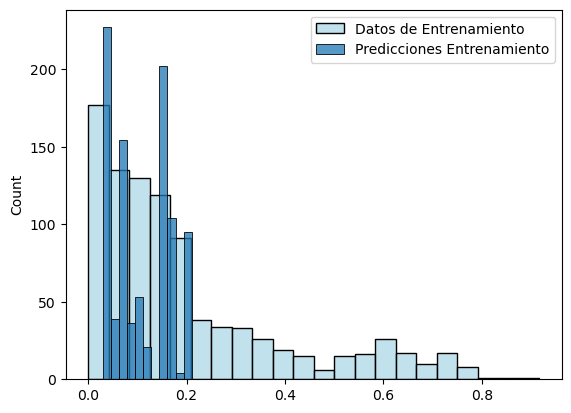

In [46]:
r2_train_5 = r2_score(y_train_desc, pred_train_desc_5)
mae_train_5 = mean_absolute_error(y_train_desc, pred_train_desc_5)
rmse_train_5 = root_mean_squared_error(y_train_desc, pred_train_desc_5)
mape_train_5 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_5)

print(f'R2 entrenamiento: {r2_train_5}')
print(f'MAE entrenamiento: {mae_train_5}')
print(f'RMSE entrenamiento: {rmse_train_5}')
print(f'MAPE entrenamiento: {mape_train_5}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_5.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: -0.1382301623076856
MAE prueba: 0.09767216113066805
RMSE prueba: 0.19436198508892416
MAPE prueba: 1.0932553535200662


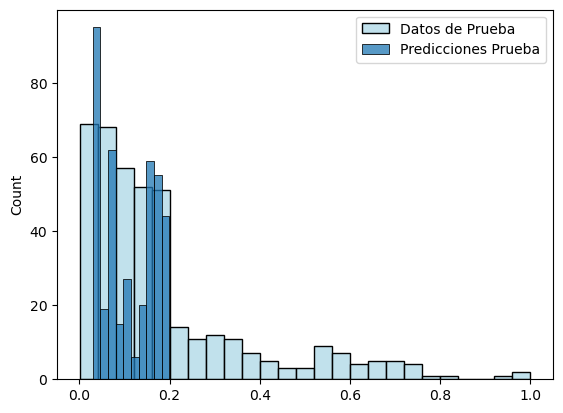

In [47]:
r2_test_5 = r2_score(y_test_desc, pred_test_desc_4)
mae_test_5 = mean_absolute_error(y_test_desc, pred_test_desc_5)
rmse_test_5 = root_mean_squared_error(y_test_desc, pred_test_desc_5)
mape_test_5 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_5)

print(f'R2 prueba: {r2_test_5}')
print(f'MAE prueba: {mae_test_5}')
print(f'RMSE prueba: {rmse_test_5}')
print(f'MAPE prueba: {mape_test_5}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_5.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### Adaptative Boosting

In [48]:
from sklearn.ensemble import AdaBoostRegressor

In [49]:
modelo_6 = AdaBoostRegressor()
param_grid = {'estimator': [DecisionTreeRegressor(), KNeighborsRegressor()], 'n_estimators': [100, 200, 400], 'loss': ['linear', 'square', 'exponential'], 'learning_rate': [0.001, 0.1, 1, 10]}
reg_6 = GridSearchCV(modelo_6, param_grid, cv=3, scoring='neg_mean_absolute_percentage_error')
reg_6.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_6.cv_results_['params']), 
                        pd.DataFrame(reg_6.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

,estimator,learning_rate,loss,n_estimators,MAPE
7,DecisionTreeRegressor(),0.001,exponential,200,-2.791587
0,DecisionTreeRegressor(),0.001,linear,100,-2.813808
22,DecisionTreeRegressor(),1.000,square,200,-2.861391
5,DecisionTreeRegressor(),0.001,square,400,-2.905683
6,DecisionTreeRegressor(),0.001,exponential,100,-2.935330
...,...,...,...,...,...
31,DecisionTreeRegressor(),10.000,square,200,-39.896358
32,DecisionTreeRegressor(),10.000,square,400,-39.896358
66,KNeighborsRegressor(),10.000,square,100,-39.896358
67,KNeighborsRegressor(),10.000,square,200,-39.896358


In [50]:
modelo_6_final = reg_6.best_estimator_
modelo_6_final

AdaBoostRegressor(estimator=DecisionTreeRegressor(), learning_rate=0.001,
                  loss='exponential', n_estimators=200)

In [51]:
pred_train_6 = modelo_6_final.predict(X_train)
pred_test_6 = modelo_6_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_6 = pred_train_6 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_6 = pred_test_6 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.9994397545118756
MAE entrenamiento: 0.00021338448245660432
RMSE entrenamiento: 0.004613745573030124
MAPE entrenamiento: 0.013379819124091143


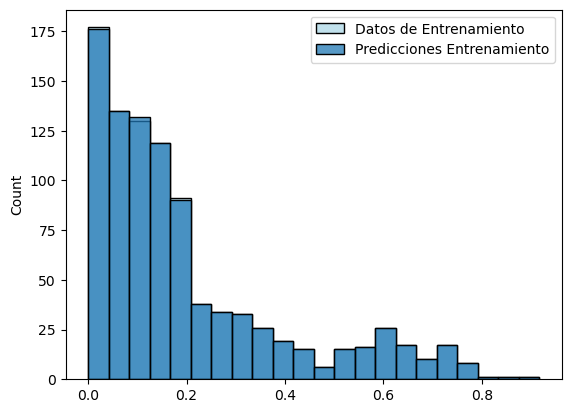

In [52]:
r2_train_6 = r2_score(y_train_desc, pred_train_desc_6)
mae_train_6 = mean_absolute_error(y_train_desc, pred_train_desc_6)
rmse_train_6 = root_mean_squared_error(y_train_desc, pred_train_desc_6)
mape_train_6 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_6)

print(f'R2 entrenamiento: {r2_train_6}')
print(f'MAE entrenamiento: {mae_train_6}')
print(f'RMSE entrenamiento: {rmse_train_6}')
print(f'MAPE entrenamiento: {mape_train_6}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_6.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: -0.4637413584857635
MAE prueba: 0.12878459062702294
RMSE prueba: 0.22835927289579006
MAPE prueba: 4.479996497083955


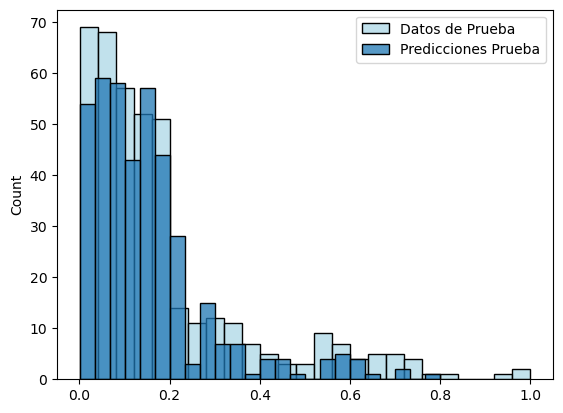

In [53]:
r2_test_6 = r2_score(y_test_desc, pred_test_desc_6)
mae_test_6 = mean_absolute_error(y_test_desc, pred_test_desc_6)
rmse_test_6 = root_mean_squared_error(y_test_desc, pred_test_desc_6)
mape_test_6 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_6)

print(f'R2 prueba: {r2_test_6}')
print(f'MAE prueba: {mae_test_6}')
print(f'RMSE prueba: {rmse_test_6}')
print(f'MAPE prueba: {mape_test_6}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_6.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### GradientBoosting

In [54]:
from sklearn.ensemble import GradientBoostingRegressor

In [55]:
modelo_7 = GradientBoostingRegressor()
# loss: ['squared_error', 'absolute_error', 'huber', 'quantile']
param_grid = {'loss': ['squared_error', 'absolute_error', 'huber', 'quantile'], 'n_estimators': [100, 200, 300, 900], 'criterion': ['friedman_mse', 'squared_error']}
reg_7 = GridSearchCV(modelo_7, param_grid, cv=3, scoring='neg_mean_absolute_percentage_error')
reg_7.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_7.cv_results_['params']), 
                        pd.DataFrame(reg_7.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

,criterion,loss,n_estimators,MAPE
20,squared_error,absolute_error,100,-1.845744
21,squared_error,absolute_error,200,-1.864117
23,squared_error,absolute_error,900,-1.875139
6,friedman_mse,absolute_error,300,-1.882577
4,friedman_mse,absolute_error,100,-1.940716
5,friedman_mse,absolute_error,200,-1.991950
7,friedman_mse,absolute_error,900,-2.013163
22,squared_error,absolute_error,300,-2.262268
3,friedman_mse,squared_error,900,-4.440740
19,squared_error,squared_error,900,-4.472194


In [56]:
modelo_7_final = reg_7.best_estimator_
modelo_7_final

GradientBoostingRegressor(criterion='squared_error', loss='absolute_error')

In [57]:
pred_train_7 = modelo_7_final.predict(X_train)
pred_test_7 = modelo_7_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_7 = pred_train_7 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_7 = pred_test_7 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: -0.09887168696236048
MAE entrenamiento: 0.10322267222140485
RMSE entrenamiento: 0.2043327356636826
MAPE entrenamiento: 0.5831740905590742


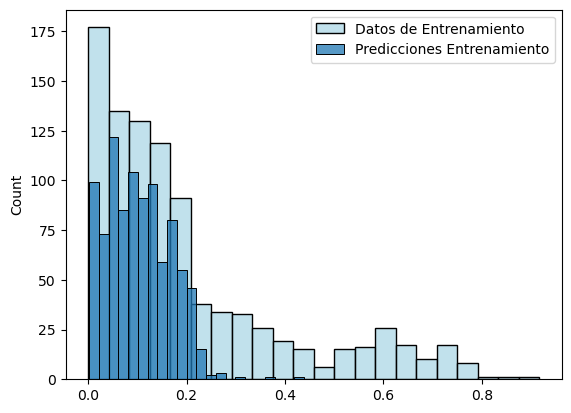

In [58]:
r2_train_7 = r2_score(y_train_desc, pred_train_desc_7)
mae_train_7 = mean_absolute_error(y_train_desc, pred_train_desc_7)
rmse_train_7 = root_mean_squared_error(y_train_desc, pred_train_desc_7)
mape_train_7 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_7)

print(f'R2 entrenamiento: {r2_train_7}')
print(f'MAE entrenamiento: {mae_train_7}')
print(f'RMSE entrenamiento: {rmse_train_7}')
print(f'MAPE entrenamiento: {mape_train_7}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_7.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: -0.1014350259729746
MAE prueba: 0.09438252882813548
RMSE prueba: 0.19809153667029217
MAPE prueba: 2.672055156305883


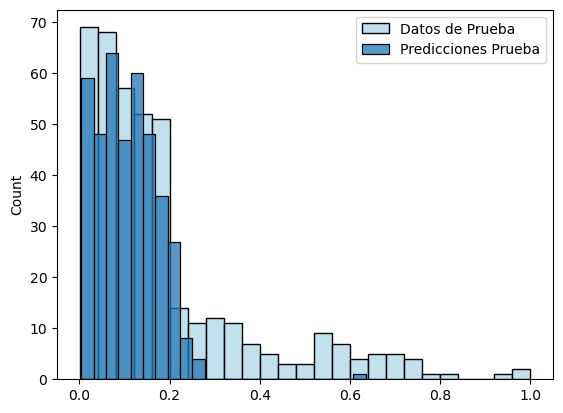

In [59]:
r2_test_7 = r2_score(y_test_desc, pred_test_desc_7)
mae_test_7 = mean_absolute_error(y_test_desc, pred_test_desc_7)
rmse_test_7 = root_mean_squared_error(y_test_desc, pred_test_desc_7)
mape_test_7 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_7)

print(f'R2 prueba: {r2_test_7}')
print(f'MAE prueba: {mae_test_7}')
print(f'RMSE prueba: {rmse_test_7}')
print(f'MAPE prueba: {mape_test_7}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_7.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### CatBoost Regressor

In [60]:
from catboost import CatBoostRegressor

In [61]:
modelo_8 = CatBoostRegressor()
param_grid = {'iterations': [100, 200, 500], 'depth': [4, 6, 8], 'learning_rate': [0.01, 0.1, 0.5, 1], 'l2_leaf_reg': [1, 3, 5]}
reg_8 = GridSearchCV(modelo_8, param_grid, cv=3, scoring='neg_mean_absolute_percentage_error', n_jobs=-1)
reg_8.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_8.cv_results_['params']), 
                        pd.DataFrame(reg_8.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

0:	learn: 0.1914571	total: 72.6ms	remaining: 7.19s
0:	learn: 0.2035782	total: 72.6ms	remaining: 7.19s
0:	learn: 0.1884358	total: 72.6ms	remaining: 7.18s
0:	learn: 0.1929157	total: 72.6ms	remaining: 7.19s
0:	learn: 0.1893215	total: 72.6ms	remaining: 7.18s
0:	learn: 0.1863865	total: 72.5ms	remaining: 7.18s
0:	learn: 0.2011632	total: 72.6ms	remaining: 7.18s
0:	learn: 0.1820452	total: 72.6ms	remaining: 7.18s
1:	learn: 0.1882610	total: 72.8ms	remaining: 3.57s
1:	learn: 0.1848327	total: 72.8ms	remaining: 3.57s
1:	learn: 0.1912652	total: 72.9ms	remaining: 3.57s
1:	learn: 0.2033545	total: 73ms	remaining: 3.58s
1:	learn: 0.1869649	total: 73ms	remaining: 3.58s
2:	learn: 0.1880502	total: 73ms	remaining: 2.36s
1:	learn: 0.1891939	total: 73.2ms	remaining: 3.59s
2:	learn: 0.1852024	total: 73.2ms	remaining: 2.37s
2:	learn: 0.1838349	total: 73.1ms	remaining: 2.37s
2:	learn: 0.2030911	total: 73.3ms	remaining: 2.37s
2:	learn: 0.1910491	total: 73.3ms	remaining: 2.37s
3:	learn: 0.1878348	total: 73.3ms	rem

,depth,iterations,l2_leaf_reg,learning_rate,MAPE
46,6,100,5,0.5,-5.013965
58,6,200,5,0.5,-5.128893
70,6,500,5,0.5,-5.199768
19,4,200,3,1.0,-5.427585
23,4,200,5,1.0,-5.566261
...,...,...,...,...,...
75,8,100,1,1.0,-8.919029
99,8,500,1,1.0,-8.927313
87,8,200,1,1.0,-8.928091
15,4,200,1,1.0,-9.100036


In [62]:
modelo_8_final = reg_8.best_estimator_
modelo_8_final

In [63]:
pred_train_8 = modelo_8_final.predict(X_train)
pred_test_8 = modelo_8_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_8 = pred_train_8 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_8 = pred_test_8 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.769916452777286
MAE entrenamiento: 0.07195635686060826
RMSE entrenamiento: 0.09349905895147631
MAPE entrenamiento: 2.0901961002312635


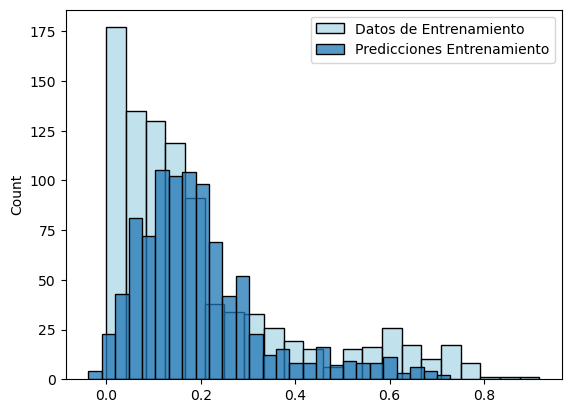

In [64]:
r2_train_8 = r2_score(y_train_desc, pred_train_desc_8)
mae_train_8 = mean_absolute_error(y_train_desc, pred_train_desc_8)
rmse_train_8 = root_mean_squared_error(y_train_desc, pred_train_desc_8)
mape_train_8 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_8)

print(f'R2 entrenamiento: {r2_train_8}')
print(f'MAE entrenamiento: {mae_train_8}')
print(f'RMSE entrenamiento: {rmse_train_8}')
print(f'MAPE entrenamiento: {mape_train_8}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_8.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: -0.18075161637437676
MAE prueba: 0.15193177678959416
RMSE prueba: 0.20510004414514624
MAPE prueba: 4.913656551761995


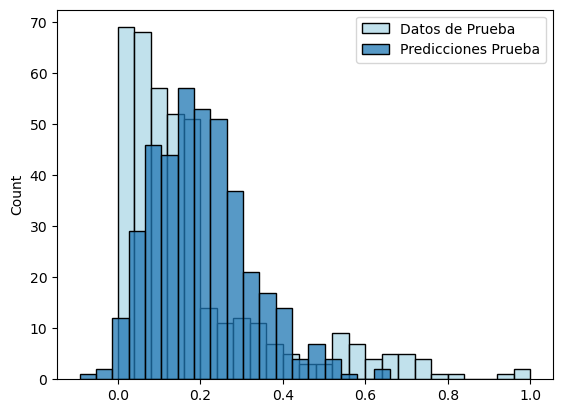

In [65]:
r2_test_8 = r2_score(y_test_desc, pred_test_desc_8)
mae_test_8 = mean_absolute_error(y_test_desc, pred_test_desc_8)
rmse_test_8 = root_mean_squared_error(y_test_desc, pred_test_desc_8)
mape_test_8 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_8)

print(f'R2 prueba: {r2_test_8}')
print(f'MAE prueba: {mae_test_8}')
print(f'RMSE prueba: {rmse_test_8}')
print(f'MAPE prueba: {mape_test_8}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_8.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### Huber Regressor

In [66]:
from sklearn.linear_model import HuberRegressor

In [67]:
modelo_9 = HuberRegressor()
modelo_9.fit(X_train, y_train)

HuberRegressor()

In [68]:
pred_train_9 = modelo_9.predict(X_train)
pred_test_9 = modelo_9.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_9 = pred_train_9 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_9 = pred_test_9 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: -0.1571064006739269
MAE entrenamiento: 0.10994337186701576
RMSE entrenamiento: 0.20967715034625997
MAPE entrenamiento: 0.3754047384178349


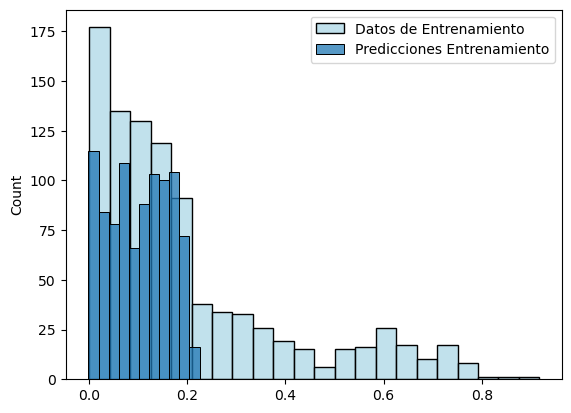

In [69]:
r2_train_9 = r2_score(y_train_desc, pred_train_desc_9)
mae_train_9 = mean_absolute_error(y_train_desc, pred_train_desc_9)
rmse_train_9 = root_mean_squared_error(y_train_desc, pred_train_desc_9)
mape_train_9 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_9)

print(f'R2 entrenamiento: {r2_train_9}')
print(f'MAE entrenamiento: {mae_train_9}')
print(f'RMSE entrenamiento: {rmse_train_9}')
print(f'MAPE entrenamiento: {mape_train_9}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_9.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: -0.07865012338291644
MAE prueba: 0.09455416291788643
RMSE prueba: 0.19603191306957052
MAPE prueba: 0.3386697103244227


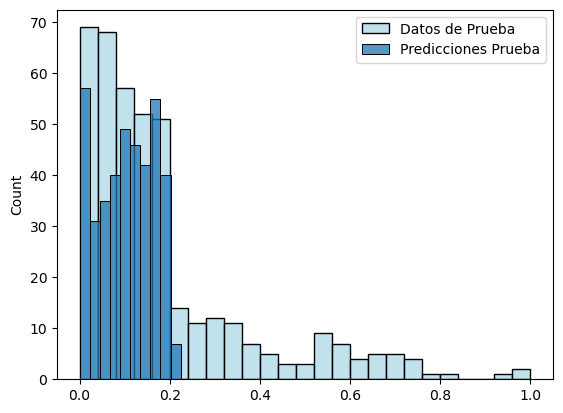

In [70]:
r2_test_9 = r2_score(y_test_desc, pred_test_desc_9)
mae_test_9 = mean_absolute_error(y_test_desc, pred_test_desc_9)
rmse_test_9 = root_mean_squared_error(y_test_desc, pred_test_desc_9)
mape_test_9 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_9)

print(f'R2 prueba: {r2_test_9}')
print(f'MAE prueba: {mae_test_9}')
print(f'RMSE prueba: {rmse_test_9}')
print(f'MAPE prueba: {mape_test_9}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_9.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### LightGBM Regressor

In [71]:
from lightgbm import LGBMRegressor

In [72]:
modelo_10 = LGBMRegressor(random_state=123)
param_grid = {'n_estimators': [100, 200, 300, 900], 'learning_rate': [0.01, 0.1, 0.5, 1], 'num_leaves': [20, 30, 40, 50], 'max_depth': [4, 6, 8]}
reg_10 = GridSearchCV(modelo_10, param_grid, cv=3, scoring='neg_mean_absolute_percentage_error', n_jobs=-1)
reg_10.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_10.cv_results_['params']), 
                        pd.DataFrame(reg_10.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001465 seconds.
You can set `force_col_wise=true` to remove the overhead.[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001744 seconds.
You can set `force_col_wise=true` to remove the overhead.

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001869 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001872 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001960 seconds.
You can set `force_col_wise=true` to remove the overhead.[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001902 seconds.
You can set `force_col_wise=true` to remove the overhead.

[LightGBM] [Info] Auto-choos

,learning_rate,max_depth,n_estimators,num_leaves,MAPE
108,0.5,4,900,20,-6.062342
109,0.5,4,900,30,-6.062342
110,0.5,4,900,40,-6.062342
111,0.5,4,900,50,-6.062342
122,0.5,6,300,40,-6.208908
...,...,...,...,...,...
89,0.1,8,300,30,-7.917939
90,0.1,8,300,40,-7.917939
131,0.5,8,100,50,-7.939064
130,0.5,8,100,40,-7.939064


In [73]:
modelo_10_final = reg_10.best_estimator_
modelo_10_final

LGBMRegressor(learning_rate=0.5, max_depth=4, n_estimators=900, num_leaves=20,
              random_state=123)

In [74]:
pred_train_10 = modelo_10_final.predict(X_train)
pred_test_10 = modelo_10_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_10 = pred_train_10 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_10 = pred_test_10 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.9692925644991515
MAE entrenamiento: 0.025179732845222527
RMSE entrenamiento: 0.03415751217511062
MAPE entrenamiento: 0.8281598926710922


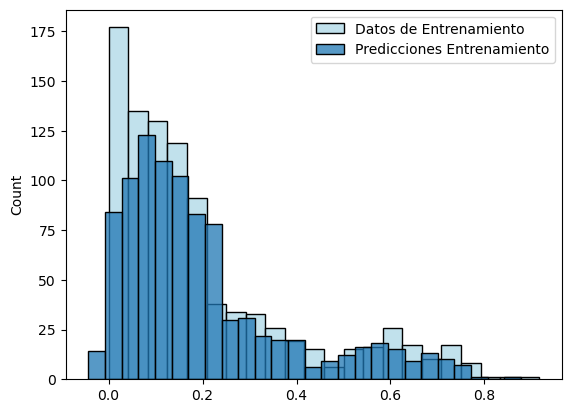

In [75]:
r2_train_10 = r2_score(y_train_desc, pred_train_desc_10)
mae_train_10 = mean_absolute_error(y_train_desc, pred_train_desc_10)
rmse_train_10 = root_mean_squared_error(y_train_desc, pred_train_desc_10)
mape_train_10 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_10)

print(f'R2 entrenamiento: {r2_train_10}')
print(f'MAE entrenamiento: {mae_train_10}')
print(f'RMSE entrenamiento: {rmse_train_10}')
print(f'MAPE entrenamiento: {mape_train_10}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_10.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: -0.5867014574889751
MAE prueba: 0.17559785634215866
RMSE prueba: 0.23775742568703515
MAPE prueba: 4.766675955922425


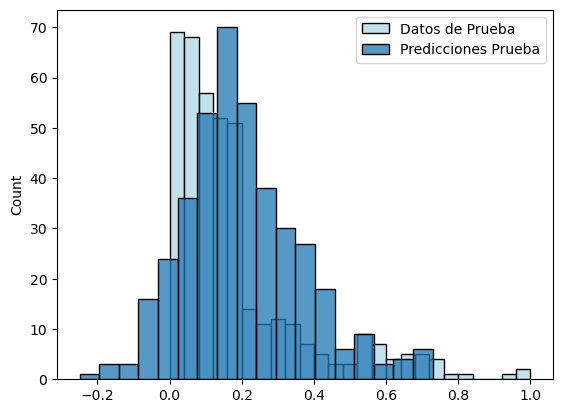

In [76]:
r2_test_10 = r2_score(y_test_desc, pred_test_desc_10)
mae_test_10 = mean_absolute_error(y_test_desc, pred_test_desc_10)
rmse_test_10 = root_mean_squared_error(y_test_desc, pred_test_desc_10)
mape_test_10 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_10)

print(f'R2 prueba: {r2_test_10}')
print(f'MAE prueba: {mae_test_10}')
print(f'RMSE prueba: {rmse_test_10}')
print(f'MAPE prueba: {mape_test_10}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_10.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### Bayesian Ridge

In [77]:
from sklearn.linear_model import BayesianRidge

In [78]:
modelo_11 = BayesianRidge()
modelo_11.fit(X_train, y_train)

BayesianRidge()

In [79]:
pred_train_11 = modelo_11.predict(X_train)
pred_test_11 = modelo_11.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_11 = pred_train_11 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_11 = pred_test_11 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.13071174006249353
MAE entrenamiento: 0.14627968136538136
RMSE entrenamiento: 0.18173825963133847
MAPE entrenamiento: 4.546204652870611


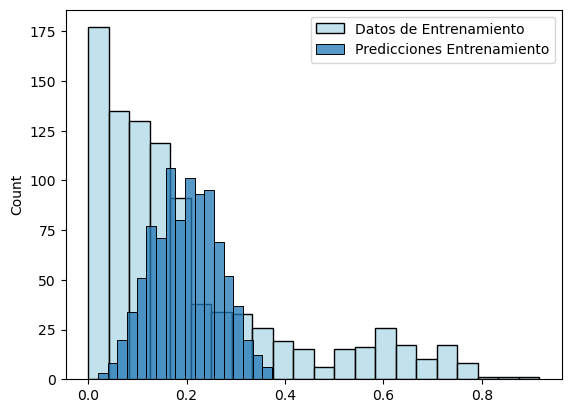

In [80]:
r2_train_11 = r2_score(y_train_desc, pred_train_desc_11)
mae_train_11 = mean_absolute_error(y_train_desc, pred_train_desc_11)
rmse_train_11 = root_mean_squared_error(y_train_desc, pred_train_desc_11)
mape_train_11 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_11)

print(f'R2 entrenamiento: {r2_train_11}')
print(f'MAE entrenamiento: {mae_train_11}')
print(f'RMSE entrenamiento: {rmse_train_11}')
print(f'MAPE entrenamiento: {mape_train_11}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_11.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: 0.10581430050280627
MAE prueba: 0.13933151029206647
RMSE prueba: 0.17848443116279783
MAPE prueba: 4.658872974197279


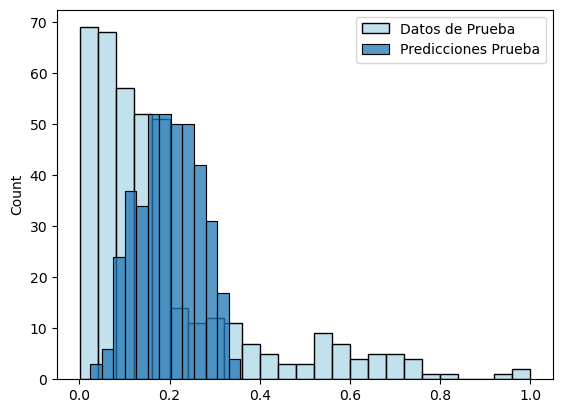

In [81]:
r2_test_11 = r2_score(y_test_desc, pred_test_desc_11)
mae_test_11 = mean_absolute_error(y_test_desc, pred_test_desc_11)
rmse_test_11 = root_mean_squared_error(y_test_desc, pred_test_desc_11)
mape_test_11 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_11)

print(f'R2 prueba: {r2_test_11}')
print(f'MAE prueba: {mae_test_11}')
print(f'RMSE prueba: {rmse_test_11}')
print(f'MAPE prueba: {mape_test_11}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_11.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### Extra Trees Regressor

In [82]:
from sklearn.ensemble import ExtraTreesRegressor

In [83]:
modelo_12 = ExtraTreesRegressor(random_state=123)
param_grid = {'n_estimators': [100, 200, 300, 900], 'criterion': ['squared_error', 'absolute_error', 'poisson'], 'max_features': ['sqrt', 'log2', None], 'bootstrap': [False]}
reg_12 = GridSearchCV(modelo_12, param_grid, cv=3, scoring='neg_mean_absolute_percentage_error', n_jobs=-1)
reg_12.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_12.cv_results_['params']), 
                        pd.DataFrame(reg_12.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

,bootstrap,criterion,max_features,n_estimators,MAPE
22,False,absolute_error,None,300,-3.927239
21,False,absolute_error,None,200,-4.076327
23,False,absolute_error,None,900,-4.097151
20,False,absolute_error,None,100,-4.187268
14,False,absolute_error,sqrt,300,-5.231188
18,False,absolute_error,log2,300,-5.231188
15,False,absolute_error,sqrt,900,-5.363919
19,False,absolute_error,log2,900,-5.363919
16,False,absolute_error,log2,100,-5.381166
12,False,absolute_error,sqrt,100,-5.381166


In [84]:
modelo_12_final = reg_12.best_estimator_
modelo_12_final

ExtraTreesRegressor(criterion='absolute_error', max_features=None,
                    n_estimators=300, random_state=123)

In [85]:
pred_train_12 = modelo_12_final.predict(X_train)
pred_test_12 = modelo_12_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_12 = pred_train_12 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_12 = pred_test_12 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.9994397545118756
MAE entrenamiento: 0.00021338448245730908
RMSE entrenamiento: 0.004613745573030124
MAPE entrenamiento: 0.013379819124094597


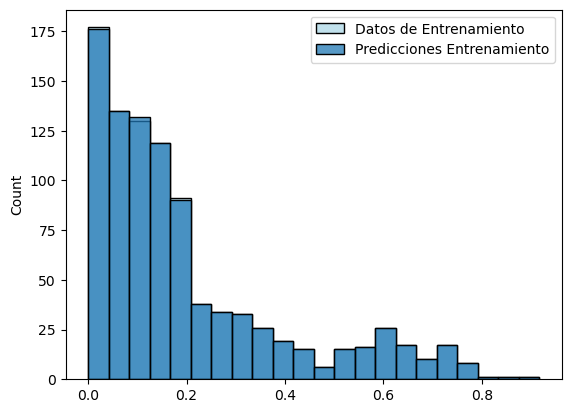

In [86]:
r2_train_12 = r2_score(y_train_desc, pred_train_desc_12)
mae_train_12 = mean_absolute_error(y_train_desc, pred_train_desc_12)
rmse_train_12 = root_mean_squared_error(y_train_desc, pred_train_desc_12)
mape_train_12 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_12)

print(f'R2 entrenamiento: {r2_train_12}')
print(f'MAE entrenamiento: {mae_train_12}')
print(f'RMSE entrenamiento: {rmse_train_12}')
print(f'MAPE entrenamiento: {mape_train_12}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_12.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: -0.3771993082818734
MAE prueba: 0.1559250314020322
RMSE prueba: 0.22150568521896236
MAPE prueba: 3.893842888088348


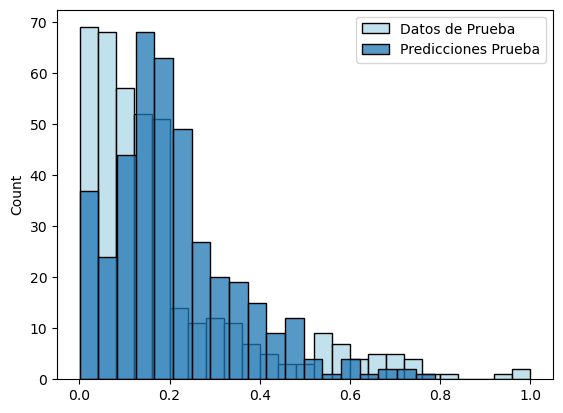

In [87]:
r2_test_12 = r2_score(y_test_desc, pred_test_desc_12)
mae_test_12 = mean_absolute_error(y_test_desc, pred_test_desc_12)
rmse_test_12 = root_mean_squared_error(y_test_desc, pred_test_desc_12)
mape_test_12 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_12)

print(f'R2 prueba: {r2_test_12}')
print(f'MAE prueba: {mae_test_12}')
print(f'RMSE prueba: {rmse_test_12}')
print(f'MAPE prueba: {mape_test_12}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_12.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()